# Charging2.0 

In [1]:
import numpy as np
import pandas as pd
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot, plot
init_notebook_mode(connected='true')

In [2]:
#loading set
pv_generation = pd.read_csv('./Data/task2/pv_train_set2.csv', parse_dates = True, index_col = 'datetime')
demand = pd.read_csv('./Data/task2/demand_train_set2.csv', parse_dates = True, index_col = 'datetime')

In [97]:
pv_generation = pv_generation.fillna(0)
demand = demand.fillna(0)

In [98]:
#interactive plotting
Generation = go.Scatter(x=pv_generation.index, y=pv_generation['pv_power_mw'].values, opacity = 1, name = 'Power Generation', line=dict(color='lightblue'), yaxis='y')
Demand = go.Scatter(x=demand.index, y=demand['demand_MW'].values, opacity = 1, name = 'Power Demand', line=dict(color='royalBlue'), yaxis='y')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'))
fig = go.Figure(data=[Generation, Demand], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

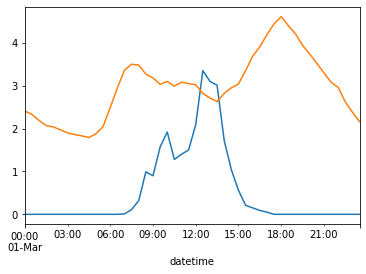

In [100]:
test_day_gen = pv_generation['pv_power_mw'].loc['2019-03-01 00:00:00':'2019-03-01 23:30:00']
test_day_dem = demand['demand_MW'].loc['2019-03-01 00:00:00':'2019-03-01 23:30:00']

test_day_gen.plot()
test_day_dem.plot();

In [101]:
#calculation of the integral of the demand load over the peaking period (15:30-21:00)

def offset(daily_demand_load_df, C_max, t0 = '15:30:00', t = '21:00:00'):
    t0 = datetime.strptime( t0 , '%H:%M:%S')
    t = datetime.strptime( t , '%H:%M:%S')
    
    #calculation of the integral with Riemann Sum.
    L = daily_demand_load_df.values #demand load
    I = 0
    for i in range(len(daily_demand_load_df.index)):
        time_ = daily_demand_load_df.index[i].time()
        
        if t0.time() <= time_ < t.time():
            I = I + 0.5*L[i]    #resulting value of the integral
    dt = t - t0
    dt = dt.seconds/3600
    A = (I - C_max)/dt
    return A

In [102]:
#reconstructing
def charge_state_from_charge_rate(charge_rate_df):
    B = charge_rate_df.values    
    C = np.zeros(len(B))
    
    for i in range(1, len(B)):
        C[i] = C[i-1] + 0.5*B[i-1]
        
    charge_state = pd.DataFrame(data=C, columns=['total_charge_MWh'], index = charge_rate_df.index )
    return charge_state

def charge_rate_from_charge_state(charge_state_df):
    C = charge_state_df.values    
    B = np.zeros(len(C))
    
    for i in range(len(C)-1):
        B[i] = 2*(C[i+1] - C[i])
        
    charge_rate = pd.DataFrame(data=B, columns=['charge_MW'], index = charge_state_df.index)
    return charge_rate

In [103]:
def get_start_end_time_generation(test_day_gen):
    for i in range(3, len(test_day_gen) - 3):
        if test_day_gen.values[i] > 0:
            if test_day_gen.values[i-1] == 0 and test_day_gen.values[i-2] == 0 and test_day_gen.values[i-3] == 0:
                ta = test_day_gen.index[i]
            if test_day_gen.values[i+1] == 0 and test_day_gen.values[i+2] == 0 and test_day_gen.values[i+3] == 0:
                tb = test_day_gen.index[i]
        else:
            ta = datetime.strptime( '07:30:00' , '%H:%M:%S')
            tb = datetime.strptime( '17:30:00' , '%H:%M:%S')
    return ta, tb

In [104]:
def adjust_probability_generation(daily_generation_df, tx = '15:00:00'):
    
    tx = datetime.strptime( tx , '%H:%M:%S')
    ta, tb = get_start_end_time_generation(daily_generation_df)

    #t_df = pd.DataFrame(data=f, columns = ['Normal'], index = daily_generation_df.index)
    #calculation of the integral with Riemann Sum.
    P = daily_generation_df.values
    I = 0
    for i in range(len(daily_generation_df.index)):
        time_ = daily_generation_df.index[i].time()
        
        if ta.time() <= time_ <= tx.time():
            I = I + 0.5*P[i]    #resulting value of the integral
            #print(I)
    B = 6/I
    P_df = pd.DataFrame(data=B*P, columns = ['Generation_Prob_[MW]'], index = daily_generation_df.index)
    return P_df

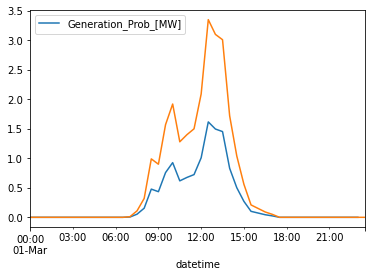

In [105]:
P = adjust_probability_generation(test_day_gen.iloc[:-1], tx = '15:00:00')
P.plot()
test_day_gen.plot();

In [106]:
def adjust_probability_demand(daily_demand_df):
    
    t_i = datetime.strptime( '15:30:00' , '%H:%M:%S')
    t_f = datetime.strptime( '20:30:00' , '%H:%M:%S')

    #t_df = pd.DataFrame(data=f, columns = ['Normal'], index = daily_generation_df.index)
    #calculation of the integral with Riemann Sum.
    P = daily_demand_df.values
    I = 0
    for i in range(len(daily_demand_df.index)):
        time_ = daily_demand_df.index[i].time()
        
        if t_i.time() <= time_ <= t_f.time():
            I = I + 0.5*P[i]    #resulting value of the integral
            #print(I)
    if I =! 0:
        B = 6/I
    else:
        B = 0
        
    P_df = pd.DataFrame(data=B*P, columns = ['Demand_P_[MW]'], index = daily_demand_df.index)
    return P_df

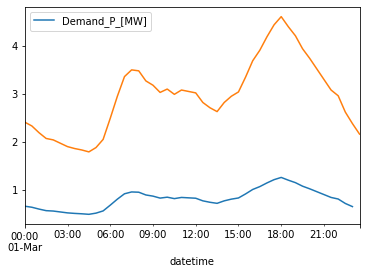

In [107]:
D = adjust_probability_demand(test_day_dem.iloc[:-1])
D.plot()
test_day_dem.plot();

In [121]:
from datetime import datetime
def battery_charge_schedule(generation_df, demand_load_df):
    #defining futures of the battery
    B_max = 2.5 #[MW]
    C_max = 6.0 #[MWh]
    C_min = 0.0 #[MWh]
    #we generate arrays with the charging rate and charge info 
    C = np.zeros(generation_df.shape[0])
    B = np.zeros(generation_df.shape[0])
    A = np.zeros(generation_df.shape[0])
    #loop over the time steps (half hours)
    P = generation_df.values #PV generation
    L = demand_load_df.values #demand load
    
    for i in range(1,len(generation_df.index)):
        date_aux = demand_load_df.index[i-1].date()
        date_ = demand_load_df.index[i].date()
        time_ = generation_df.index[i].time()
        #calculating daily demand and generation probabilities
        dti = datetime.strptime(str(date_) + ' ' + str('00:00:00'), '%Y-%m-%d %H:%M:%S')
        dtf = datetime.strptime(str(date_) + ' ' + str('23:30:00'), '%Y-%m-%d %H:%M:%S')
        daily_demand_load_df = demand_load_df.loc[dti:dtf]
        daily_generation_df = generation_df.loc[dti:dtf]

        demand_load_prob_df = adjust_probability_demand(daily_demand_load_df)
        generation_prob_df = adjust_probability_generation(daily_generation_df, tx = '15:00:00')
        #print(date_, time_)
        if i == 1:
            p = generation_prob_df.values
            l = demand_load_prob_df.values
        elif (date_ - date_aux).total_seconds() != 0:
            p = np.concatenate((p, generation_prob_df.values))
            l = np.concatenate((l, demand_load_prob_df.values))
        #conditions for charging period.
        if datetime.strptime('04:30:00', '%H:%M:%S').time() < time_ <= datetime.strptime('15:30:00', '%H:%M:%S').time():
                
                
            if C[i-1] == C_max:
                C[i] = C_max
            elif C[i-1] + 0.5*B[i-1] <= C_max:
                C[i] = C[i-1] + 0.5*B[i-1]
            elif C[i-1] + 0.5*B[i-1] > C_max:
                if C[i-1] == C_max:
                    C[i] = C_max
                elif C[i-1] < C_max: 
                    B[i-1] = 2*(C_max - C[i-1])
                    C[i] = C[i-1] + 0.5*B[i-1]
                if C[i] > C_max:
                    C[i] = C_max      
                    
            if p[i] > B_max:
                B[i] = B_max # + delta
            if p[i] <= B_max:
                B[i] = p[i] # + delta
            if C[i] == C_max:
                B[i] = 0.0
            if time_ == datetime.strptime('15:30:00', '%H:%M:%S').time():
                B[i] = 0        #discharging
        

        #conditional for the peak period.
        if datetime.strptime('15:30:00', '%H:%M:%S').time() <= time_ <= datetime.strptime('20:30:00', '%H:%M:%S').time():
            
            if l[i] > B_max:
                B[i] = - B_max
            elif 0 <= l[i] < B_max: 
                B[i] = - l[i]
            else:
                B[i] = 0.0
                
            if C[i-1] == C_min:
                C[i] = C_min
                B[i] = 0.0
            elif C[i-1] > C_min:
                C[i] = C[i-1] + 0.5*B[i-1]
                if C[i] < C_min:
                    C[i] = C_min
        
    Charge_rate = pd.DataFrame(data = B, index = generation_df.index, columns = ['charge_MW'])
    Total_charge = pd.DataFrame(data = C, index = generation_df.index, columns = ['total_charge_MWh'])
    Offset =  pd.DataFrame(data = A, index = generation_df.index, columns = ['daily_offset'])

    return Charge_rate , Total_charge, Offset

In [122]:
Charge_rate_test, total_charge, offset_daily = battery_charge_schedule(test_day_gen, test_day_dem)


In [123]:
charge_rate_reconstructed = charge_rate_from_charge_state(total_charge)
charge_state_reconstructed = charge_state_from_charge_rate(charge_rate_reconstructed)
charge_rate_reconstructed.values.max(), charge_state_reconstructed.values.max(), charge_rate_reconstructed.values.min(), charge_state_reconstructed.values.min()

(1.6170555108608209, 6.0, -1.2572727272727278, 0.0)

In [124]:
#interactive plotting
Generation = go.Scatter(x=test_day_gen.index, y=test_day_gen.values, opacity = 1, name = 'Power Generation', line=dict(color='lightblue'), yaxis='y')
Demand = go.Scatter(x=test_day_dem.index, y=test_day_dem.values, opacity = 1, name = 'Power Demand', line=dict(color='royalBlue'), yaxis='y')
Demand_p = go.Scatter(x=test_day_dem.index, y=test_day_dem.values, mode='markers', opacity = 1, name = 'Power Demand', line=dict(color='lightgreen'), yaxis='y')

Charge_Profile = go.Scatter(x=Charge_rate_test.index, y=Charge_rate_test['charge_MW'].values, opacity = 1, name = 'Battery Charge Rate', line=dict(color='crimson'), yaxis='y')
Charge_Profile_p = go.Scatter(x=Charge_rate_test.index, y=Charge_rate_test['charge_MW'].values, mode = 'markers', opacity = 1, name = 'Battery Charge Rate', line=dict(color='yellow'), yaxis='y')
Charge_Profile_r = go.Scatter(x=charge_rate_reconstructed.index, y=charge_rate_reconstructed['charge_MW'].values, opacity = 1, name = 'Battery Charge Rate Reconstructed', line=dict(color='purple'), yaxis='y')

Total_charge = go.Scatter(x=total_charge.index, y=total_charge['total_charge_MWh'].values, opacity = 1, name = 'Battery Charge State', line=dict(color='magenta'), yaxis='y2')
Total_charge_r = go.Scatter(x=charge_state_reconstructed.index, y=charge_state_reconstructed['total_charge_MWh'].values, opacity = 1, name = 'Battery Charge State Reconstructed', line=dict(color='green'), yaxis='y2')

Offset = go.Scatter(x=offset_daily.index, y=offset_daily['daily_offset'].values, opacity = 1, name = 'Offset', line=dict(color='black'), yaxis='y')

t0 = datetime.strptime('2019-03-01 15:30:00', '%Y-%m-%d %H:%M:%S')
t = datetime.strptime('2019-03-01 21:00:00', '%Y-%m-%d %H:%M:%S')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'),
                  yaxis2=dict(title='MWh Average', side='right', overlaying='y'))
fig = go.Figure(data=[Generation, Demand, Demand_p, Charge_Profile, Charge_Profile_p, Charge_Profile_r, Total_charge, Total_charge_r, Offset], layout=layout)
fig.add_vline(x=t0)
fig.add_vline(x=t)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

In [125]:
#repeating for the whole dataset
Charge_rate_all, total_charge_all, offset_all = battery_charge_schedule(pv_generation['pv_power_mw'], demand['demand_MW'])

<ipython-input-104-68f8a33b0994>:16: RuntimeWarning:

divide by zero encountered in double_scalars

<ipython-input-104-68f8a33b0994>:17: RuntimeWarning:

invalid value encountered in multiply



In [126]:
charge_rate_reconstructed = charge_rate_from_charge_state(total_charge_all)
charge_state_reconstructed = charge_state_from_charge_rate(charge_rate_reconstructed)
charge_rate_reconstructed.values.max(), charge_state_reconstructed.values.max(), charge_rate_reconstructed.values.min(), charge_state_reconstructed.values.min()

(2.500000000000001, 6.0, -1.3666619856761688, 0.0)

In [127]:
total_charge_all.values.max(), Charge_rate_all.values.max()

(6.0, 2.5)

In [128]:
Generation = go.Scatter(x=pv_generation['pv_power_mw'].index, y=pv_generation['pv_power_mw'].values, opacity = 0.7, name = 'Power Generation', line=dict(color='lightblue'), yaxis='y')
Demand = go.Scatter(x=demand.index, y=demand.values, opacity = 0.7, name = 'Power Demand', line=dict(color='royalBlue'), yaxis='y')
Demand_p = go.Scatter(x=test_day_dem.index, y=test_day_dem.values, mode='markers', opacity = 1, name = 'Power Demand', line=dict(color='lightgreen'), yaxis='y')

Charge_Profile = go.Scatter(x=Charge_rate_all.index, y=Charge_rate_all['charge_MW'].values, opacity = 0.7, name = 'Battery Charge Rate', line=dict(color='crimson'), yaxis='y')
Charge_Profile_p = go.Scatter(x=Charge_rate_all.index, y=Charge_rate_all['charge_MW'].values, mode = 'markers', opacity = 1, name = 'Battery Charge Rate', line=dict(color='yellow'), yaxis='y')
Charge_Profile_r = go.Scatter(x=charge_rate_reconstructed.index, y=charge_rate_reconstructed['charge_MW'].values, opacity = 1, name = 'Battery Charge Rate Reconstructed', line=dict(color='purple'), yaxis='y')

Total_charge = go.Scatter(x=total_charge_all.index, y=total_charge_all['total_charge_MWh'].values, opacity = 0.7, name = 'Battery Charge State', line=dict(color='magenta'), yaxis='y2')
Total_charge_r = go.Scatter(x=charge_state_reconstructed.index, y=charge_state_reconstructed['total_charge_MWh'].values, opacity = 1, name = 'Battery Charge State Reconstructed', line=dict(color='green'), yaxis='y2')

Offset = go.Scatter(x=offset_all.index, y=offset_all['daily_offset'].values, opacity = 1, name = 'Offset', line=dict(color='black'), yaxis='y')


layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'),
                  yaxis2=dict(title='MWh Average', side='right', overlaying='y'))
fig = go.Figure(data=[Generation, Demand, Demand_p, Charge_Profile, Charge_Profile_p, Charge_Profile_r, Total_charge, Total_charge_r, Offset], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

----

For task number 3 we'll asume that the week to predict behaves exactly as the week before.


In [140]:
pv_generation_pred = pv_generation.iloc[-336:]
demand_pred = demand.iloc[-336:]

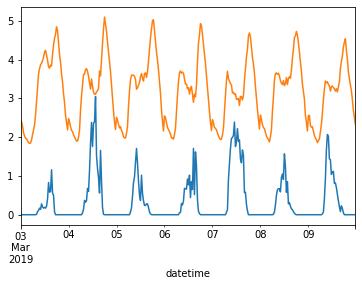

In [141]:
gen_pred = pv_generation_pred['pv_power_mw']
dem_pred = demand_pred['demand_MW']

gen_pred.plot()
dem_pred.plot();

In [142]:
submision = pd.read_csv('./Data/task2/teamname_set2.csv', parse_dates = True, index_col = 'datetime')

In [143]:
Charge_rate_predict, total_charge_predict, offset_predict = battery_charge_schedule(gen_pred, dem_pred)

In [145]:
Generation = go.Scatter(x=gen_pred.index, y=gen_pred.values, opacity = 0.7, name = 'Power Generation Forecast', line=dict(color='lightblue'), yaxis='y')
Demand = go.Scatter(x=dem_pred.index, y=dem_pred.values, opacity = 0.7, name = 'Forecasted Power Demand', line=dict(color='royalBlue'), yaxis='y')

Charge_Profile_r = go.Scatter(x=Charge_rate_predict.index, y=Charge_rate_predict['charge_MW'].values, opacity = 1, name = 'Battery Charge Rate', line=dict(color='purple'), yaxis='y')

Total_charge = go.Scatter(x=total_charge_predict.index, y=total_charge_predict['total_charge_MWh'].values, opacity = 0.7, name = 'Battery Charge State', line=dict(color='magenta'), yaxis='y2')

Offset = go.Scatter(x=offset_predict.index, y=offset_predict['daily_offset'].values, opacity = 1, name = 'Offset', line=dict(color='black'), yaxis='y')


layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'),
                  yaxis2=dict(title='MWh Average', side='right', overlaying='y'))
fig = go.Figure(data=[Generation, Demand, Charge_Profile_r, Total_charge, Offset], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

In [146]:
task2 = pd.DataFrame(data=Charge_rate_predict.values, columns = Charge_rate_predict.columns, index = submision.index)

In [151]:
task2.head(50)

,charge_MW
datetime,
2019-03-10 00:00:00,0.000000
2019-03-10 00:30:00,0.000000
2019-03-10 01:00:00,0.000000
2019-03-10 01:30:00,0.000000
2019-03-10 02:00:00,0.000000
2019-03-10 02:30:00,0.000000
2019-03-10 03:00:00,0.000000
2019-03-10 03:30:00,0.000000
2019-03-10 04:00:00,0.000000


In [152]:
sum(task2.values)

array([1.67643677e-14])

In [153]:
task2.to_csv('./IERFC_set2.csv')